In [6]:
# 중력방향 정렬
import trimesh
import numpy as np
from scipy.spatial.transform import Rotation

# GLB 로드
scene = trimesh.load('../output/scene.glb')

# ARCore 중력 방향 → GLB 계산
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

# Z+ 방향으로 회전
R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

# 렌더링 확인
# 축 길이 설정
axis_length = 1

# 원점 (0, 0, 0) 사용
origin = np.array([0, 0, 0])

# 원점 (0, 0, 0)에 포인트 생성
# 방법 1: 작은 구(sphere) 사용
origin_point = trimesh.creation.icosphere(radius=0.005)  # 반지름 0.01
origin_point.apply_translation([0, 0, 0])  # 원점으로 이동
origin_point.visual.face_colors = [255, 255, 0, 255]  # 노란색


height_point = trimesh.creation.icosphere(radius=0.01)  # 반지름 0.01
height_point.apply_translation([0.187143, 0.074304,0.0866 ])  # 원점으로 이동
height_point.visual.face_colors = [255, 255, 0, 255]  # 노란색


# X축 (빨강)
x_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
x_line.apply_transform(trimesh.transformations.rotation_matrix(
    np.pi/2, [0, 1, 0], [0, 0, 0]
))
x_line.apply_translation(origin + [axis_length/2, 0, 0])  # 원점 기준
x_line.visual.face_colors = [255, 0, 0, 255]

# Y축 (초록)
y_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
y_line.apply_transform(trimesh.transformations.rotation_matrix(
    -np.pi/2, [1, 0, 0], [0, 0, 0]
))
y_line.apply_translation(origin + [0, axis_length/2, 0])  # 원점 기준
y_line.visual.face_colors = [0, 255, 0, 255]

# Z축 (파랑)
z_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
z_line.apply_translation(origin + [0, 0, axis_length/2])  # 원점 기준
z_line.visual.face_colors = [0, 0, 255, 255]

# 씬에 추가
scene.add_geometry([x_line, y_line, z_line,height_point])
scene.show()

In [5]:
# 중력방향 정렬
import trimesh
import numpy as np
from scipy.spatial.transform import Rotation
from scipy.spatial import ConvexHull

# GLB 로드
scene = trimesh.load('../output/scene.glb')

# ARCore 중력 방향 → GLB 계산
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

# Z+ 방향으로 회전
R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

# 포인트 클라우드 추출
def get_vertices_from_scene(scene):
    """씬에서 모든 포인트 추출"""
    vertices_list = []
    if isinstance(scene, trimesh.Scene):
        for geom in scene.geometry.values():
            if hasattr(geom, 'vertices'):
                vertices_list.append(geom.vertices)
    else:
        if hasattr(scene, 'vertices'):
            vertices_list.append(scene.vertices)
    if len(vertices_list) == 0:
        return None
    return np.vstack(vertices_list)

points = get_vertices_from_scene(scene)
print(f"전체 포인트 개수: {len(points):,}개")
print(f"Z 범위: {points[:, 2].min():.4f}m ~ {points[:, 2].max():.4f}m")

# 고정 셀 크기 Grid Coverage 기반 평면 판별
def is_plane_by_grid_coverage_fixed_cell(points_2d, 
                                         cell_size=0.01,
                                         min_coverage=0.3):
    """고정 셀 크기로 평면 판별"""
    if len(points_2d) < 10:
        return False, 0, {}
    
    x_min, x_max = points_2d[:, 0].min(), points_2d[:, 0].max()
    y_min, y_max = points_2d[:, 1].min(), points_2d[:, 1].max()
    
    x_range = x_max - x_min
    y_range = y_max - y_min
    
    x_cells = int(np.ceil(x_range / cell_size))
    y_cells = int(np.ceil(y_range / cell_size))
    
    if x_cells == 0 or y_cells == 0:
        return False, 0, {}
    
    actual_x_range = x_cells * cell_size
    actual_y_range = y_cells * cell_size
    
    grid_x_min = x_min - (actual_x_range - x_range) / 2
    grid_y_min = y_min - (actual_y_range - y_range) / 2
    
    grid_x = ((points_2d[:, 0] - grid_x_min) / cell_size).astype(int)
    grid_y = ((points_2d[:, 1] - grid_y_min) / cell_size).astype(int)
    
    grid_x = np.clip(grid_x, 0, x_cells - 1)
    grid_y = np.clip(grid_y, 0, y_cells - 1)
    
    occupied_cells = set(zip(grid_y, grid_x))
    total_cells = x_cells * y_cells
    coverage = len(occupied_cells) / total_cells if total_cells > 0 else 0.0
    
    is_plane = coverage >= min_coverage
    
    info = {
        "occupied_cells": len(occupied_cells),
        "total_cells": total_cells,
        "coverage": coverage,
        "cell_size": cell_size,
        "x_cells": x_cells,
        "y_cells": y_cells
    }
    
    return is_plane, len(occupied_cells), info

# 다중 평면 검출
def detect_planes_by_grid_coverage(points, 
                                   z_bins=300,
                                   cell_size=0.01,
                                   min_coverage=0.3,
                                   min_points_per_slice=20):
    """Z값 구간별로 나누어 Grid Coverage 방식으로 평면 검출"""
    z_min, z_max = points[:, 2].min(), points[:, 2].max()
    z_ranges = np.linspace(z_min, z_max, z_bins + 1)
    
    detected_planes = []
    
    for i in range(len(z_ranges) - 1):
        z_low = z_ranges[i]
        z_high = z_ranges[i + 1]
        z_mid = (z_low + z_high) / 2
        
        mask = (points[:, 2] >= z_low) & (points[:, 2] < z_high)
        slice_points = points[mask]
        
        if len(slice_points) < min_points_per_slice:
            continue
        
        is_plane, occupied_cells, info = is_plane_by_grid_coverage_fixed_cell(
            slice_points[:, :2],
            cell_size=cell_size,
            min_coverage=min_coverage
        )
        
        if is_plane:
            detected_planes.append({
                'z_range': (z_low, z_high),
                'z_mean': z_mid,
                'points': slice_points,
                'occupied_cells': occupied_cells,
                'n_points': len(slice_points),
                'info': info
            })
    
    detected_planes.sort(key=lambda x: x['occupied_cells'], reverse=True)
    return detected_planes

# 평면 검출 실행
print("\n=== 평면 검출 중 ===")
detected_planes = detect_planes_by_grid_coverage(
    points,
    z_bins=300,
    cell_size=0.01,
    min_coverage=0.3,
    min_points_per_slice=20
)

# 점유된 셀 개수가 가장 많은 평면 선택
if len(detected_planes) > 0:
    best_plane = detected_planes[0]
    
    print(f"\n=== 가장 높은 점수 평면 (점유 셀 개수) ===")
    print(f"높이: {best_plane['z_mean']:.4f}m")
    print(f"점유 셀 개수: {best_plane['occupied_cells']}개 (점수)")
    print(f"전체 셀 개수: {best_plane['info']['total_cells']}개")
    print(f"커버리지: {best_plane['info']['coverage']:.3f} ({best_plane['info']['coverage']*100:.1f}%)")
    print(f"포인트 수: {best_plane['n_points']:,}개")
    
    # 반투명 평면 메시만 시각화
    points_2d = best_plane['points'][:, :2]
    if len(points_2d) >= 3:
        try:
            # 컨벡스 헐로 평면 범위 계산
            hull = ConvexHull(points_2d)
            hull_points = points_2d[hull.vertices]
            
            # 3D로 변환 (Z값은 평면의 평균 높이)
            z_value = best_plane['z_mean']
            vertices_3d = np.column_stack([hull_points, np.full(len(hull_points), z_value)])
            
            # 면 생성
            faces = []
            for j in range(1, len(vertices_3d) - 1):
                faces.append([0, j, j + 1])
            
            if len(faces) > 0:
                plane_mesh = trimesh.Trimesh(vertices=vertices_3d, faces=faces)
                # 반투명 초록색 (알파값 0.3)
                plane_mesh.visual.face_colors = [0, 255, 0, 76]  # RGBA: 초록, 반투명
                scene.add_geometry(plane_mesh)
                print(f"\n반투명 평면 메시 생성 완료")
        except Exception as e:
            print(f"평면 메시 생성 실패: {e}")
else:
    print("평면을 찾지 못했습니다.")

# 축 시각화
axis_length = 1
origin = np.array([0, 0, 0])

origin_point = trimesh.creation.icosphere(radius=0.005)
origin_point.apply_translation([0, 0, 0])
origin_point.visual.face_colors = [255, 255, 0, 255]

x_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
x_line.apply_transform(trimesh.transformations.rotation_matrix(
    np.pi/2, [0, 1, 0], [0, 0, 0]
))
x_line.apply_translation(origin + [axis_length/2, 0, 0])
x_line.visual.face_colors = [255, 0, 0, 255]

y_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
y_line.apply_transform(trimesh.transformations.rotation_matrix(
    -np.pi/2, [1, 0, 0], [0, 0, 0]
))
y_line.apply_translation(origin + [0, axis_length/2, 0])
y_line.visual.face_colors = [0, 255, 0, 255]

z_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
z_line.apply_translation(origin + [0, 0, axis_length/2])
z_line.visual.face_colors = [0, 0, 255, 255]

scene.add_geometry([x_line, y_line, z_line, origin_point])

print("\n씬을 표시합니다...")
scene.show()

전체 포인트 개수: 1,000,816개
Z 범위: -0.7665m ~ 0.6238m

=== 평면 검출 중 ===

=== 가장 높은 점수 평면 (점유 셀 개수) ===
높이: -0.0181m
점유 셀 개수: 2330개 (점수)
전체 셀 개수: 7171개
커버리지: 0.325 (32.5%)
포인트 수: 80,896개

반투명 평면 메시 생성 완료

씬을 표시합니다...


In [86]:
# 중심축 기반 부피 계산
import trimesh
import numpy as np
from scipy.spatial.transform import Rotation
from scipy.optimize import least_squares

# 상수 정의


THICKNESS = 0.0003 ##단면의 두께
MIN_POINTS_PER_SLICE = 10 ##원 검출 시 최소 포인트 수
MAX_CONSECUTIVE_FAILURES = 10 ##원 검출 시 최대 연속 실패 횟수
MIN_RADIUS, MAX_RADIUS = 0.02, 0.1 ##원 검출 시 최소 및 최대 반지름
MIN_POINTS_PER_METER = 50.0 ##중심축 기반 원검출시 최소 포인트 수
MIN_ANGLE_COVERAGE_THRESHOLD = 0.15  # 원 검출 시 최소 각도 커버리지 (20% 이상)



# 새로운 바닥 검출 파라미터
BOTTOM_SEARCH_RADIUS = 0.02   # 중심축으로부터 2cm 범위 (20mm)
BOTTOM_GRID_SIZE = 20          # 그리드 20x20 = 400개 셀
MIN_BOTTOM_GRID_COVERAGE = 0.2  # 바닥 검출을 위한 최소 그리드 커버리지 (0.0 ~ 1.0, 10% 이상)
BOTTOM_SEARCH_RATIO = 0.3     # 하위 30%만 바닥 검출

# 중심축 선정을 위한 지표 가중치
WEIGHT_PPM = 0.5
WEIGHT_ANGLE_COVERAGE = 0
WEIGHT_GRID_COVERAGE = 0
WEIGHT_INLIER_RATIO = 0.5

# 그리드 기반 커버리지 계산 파라미터
GRID_SIZE = 40  
INNER_RADIUS_RATIO_FOR_GRID = 0.8  # 원 반지름의 60% 이내

# 각도 커버리지 계산 파라미터
ANGLE_SEGMENTS = 180  

# GLB 로드 및 z축이 중력방향이 되도록 scene을 회전하는 함수
def load_and_align_scene(filepath):
    scene = trimesh.load(filepath)
    A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
    gravity = (A[:3, :3] @ np.array([[1,0,0],[0,-1,0],[0,0,-1]]) @ np.array([0,1,0]))
    gravity = gravity / np.linalg.norm(gravity)
    
    R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
    T = np.eye(4)
    T[:3, :3] = R.as_matrix()
    for geom in scene.geometry.values():
        geom.apply_transform(T)
    
    for geometry in scene.geometry.values():
        if isinstance(geometry, trimesh.PointCloud):
            return geometry.vertices
    return None


# 원 검출 함수들

def calculate_ppm(inlier_points, radius):
    """둘레당 인라이너 포인트 수 계산 (Points Per Meter)"""
    if radius <= 0:
        return 0.0
    circumference = 2 * np.pi * radius
    n_inliers = len(inlier_points)
    ppm = n_inliers / circumference if circumference > 0 else 0
    return ppm

def calculate_angle_coverage(inlier_points, center):
    """인라이너가 원 둘레를 커버하는 정도 계산 (0.0 ~ 1.0)"""
    if len(inlier_points) == 0:
        return 0.0
    
    # 각 포인트의 각도 계산
    relative_points = inlier_points - center
    angles = np.arctan2(relative_points[:, 1], relative_points[:, 0])
    
    # 각도를 0~2π 범위로 정규화
    angles = (angles + 2 * np.pi) % (2 * np.pi)
    
    # 각도 구간으로 나누기
    segment_size = 2 * np.pi / ANGLE_SEGMENTS
    segment_indices = (angles / segment_size).astype(int)
    segment_indices = np.clip(segment_indices, 0, ANGLE_SEGMENTS - 1)
    
    # 커버된 구간 수 계산
    covered_segments = len(np.unique(segment_indices))
    coverage = covered_segments / ANGLE_SEGMENTS
    
    return coverage

def calculate_grid_coverage(points_2d, center, radius, inner_radius_ratio=INNER_RADIUS_RATIO_FOR_GRID, grid_size=GRID_SIZE):
    """그리드 기반 면적 커버리지 계산 (0.0 ~ 1.0, 낮을수록 좋음)"""
    inner_radius = radius * inner_radius_ratio
    
    # 내부 포인트 필터링
    distances = np.linalg.norm(points_2d - center, axis=1)
    inner_points = points_2d[distances < inner_radius]
    
    if len(inner_points) == 0:
        return 0.0  # 완전히 비어있음 (최고)
    
    # 그리드 범위 계산
    x_min, x_max = center[0] - inner_radius, center[0] + inner_radius
    y_min, y_max = center[1] - inner_radius, center[1] + inner_radius
    
    # 그리드 셀 크기
    cell_size_x = (x_max - x_min) / grid_size
    cell_size_y = (y_max - y_min) / grid_size
    
    if cell_size_x <= 0 or cell_size_y <= 0:
        return 0.0
    
    # 각 포인트가 속한 그리드 셀 인덱스 계산
    grid_x = ((inner_points[:, 0] - x_min) / cell_size_x).astype(int)
    grid_y = ((inner_points[:, 1] - y_min) / cell_size_y).astype(int)
    
    # 그리드 범위 내로 클리핑
    grid_x = np.clip(grid_x, 0, grid_size - 1)
    grid_y = np.clip(grid_y, 0, grid_size - 1)
    
    # 포인트가 있는 셀 찾기
    occupied_cells = set(zip(grid_x, grid_y))
    coverage = len(occupied_cells) / (grid_size * grid_size)
    
    return coverage

# 인라이너 포인트들을 받아서 원의 중심과 반지름을 정확하게 추정하는 함수
def refine_circle_ls(inlier_points):
    if len(inlier_points) < 3:
        return None
    center_init = inlier_points.mean(axis=0)
    radius_init = np.mean(np.linalg.norm(inlier_points - center_init, axis=1))
    
    def residuals(params):
        cx, cy, r = params
        return np.linalg.norm(inlier_points - [cx, cy], axis=1) - r
    
    try:
        result = least_squares(residuals, [center_init[0], center_init[1], radius_init],
                              bounds=([-0.5, -0.5, 0.001], [0.5, 0.5, 0.2]))
        cx, cy, r = result.x
        if 0.01 < r < 0.15:
            return {'center': np.array([cx, cy]), 'radius': r}
    except:
        pass
    return None

# 랜덤 샘플링을 통해 원을 추정하는 함수.한 단면에서 최적의 원을 찾을 때는 단순히 가장 원다운 원(인라이너 비율)을 찾음.
# 여러 단면에서 나온 원들 중에에 중심축을 추정하기 위한 단면을 고를때는 원점과 원중심까지의 거리를 고려해서 상위 5개의 단면의 원들의 중앙값 사용용
def fit_circle_ransac(points_2d, n_iter=200, threshold=0.005, min_inliers=10):
    if len(points_2d) < 3:
        return None
    
    # PPM 제외한 가중치 정규화 (합이 1이 되도록)
    sum_without_ppm = WEIGHT_ANGLE_COVERAGE + WEIGHT_GRID_COVERAGE + WEIGHT_INLIER_RATIO
    weight_angle_norm = WEIGHT_ANGLE_COVERAGE / sum_without_ppm
    weight_grid_norm = WEIGHT_GRID_COVERAGE / sum_without_ppm
    weight_inlier_norm = WEIGHT_INLIER_RATIO / sum_without_ppm
    
    best_circle, best_score = None, -1.0
    for _ in range(n_iter):
        p1, p2, p3 = points_2d[np.random.choice(len(points_2d), 3, replace=False)]
        try:
            A = np.array([[2*(p2[0]-p1[0]), 2*(p2[1]-p1[1])],
                         [2*(p3[0]-p1[0]), 2*(p3[1]-p1[1])]])
            b = np.array([p2[0]**2 - p1[0]**2 + p2[1]**2 - p1[1]**2,
                         p3[0]**2 - p1[0]**2 + p3[1]**2 - p1[1]**2])
            center = np.linalg.solve(A, b)
            radius = np.linalg.norm(p1 - center)
            
            if not (0.01 < radius < 0.15):
                continue
            
            distances = np.abs(np.linalg.norm(points_2d - center, axis=1) - radius)
            inliers = distances < threshold
            n_inliers = np.sum(inliers)
            
            if n_inliers < min_inliers:
                continue
            
            # refine
            refined = refine_circle_ls(points_2d[inliers])
            if refined:
                # 인라이너 포인트 추출
                inlier_points = points_2d[inliers]
                inlier_ratio = n_inliers / len(points_2d)
                
                # 지표 계산 (정규화 불필요, 이미 0~1 범위)
                angle_coverage = calculate_angle_coverage(inlier_points, refined['center'])
                grid_coverage = calculate_grid_coverage(points_2d, refined['center'], refined['radius'])
                grid_coverage_inverted = 1.0 - grid_coverage  # 반전 (낮을수록 좋음)
                
                # 곱셈 방식으로 점수 계산 (가중치를 지수로 사용)
                # 0 방지를 위해 작은 값 추가
                score = ((inlier_ratio + 1e-8) ** weight_inlier_norm * 
                        (angle_coverage + 1e-8) ** weight_angle_norm * 
                        (grid_coverage_inverted + 1e-8) ** weight_grid_norm)
                
                if score > best_score:
                    best_score = score
                    # PPM은 나중에 계산 (중심축 선정용)
                    ppm = calculate_ppm(inlier_points, refined['radius'])
                    best_circle = {
                        **refined, 
                        'score': inlier_ratio,  # 기존 호환성
                        'n_inliers': n_inliers,
                        'ppm': ppm,
                        'angle_coverage': angle_coverage,
                        'grid_coverage': grid_coverage
                    }
        except np.linalg.LinAlgError:
            continue
    return best_circle

def detect_circle_at_axis(slice_2d, center_axis, n_iter=30, threshold=0.0025, prefer_inner=True, max_radius=None): # 원둘레 중위 2.5mm는 인라이어어
    """중심축 기반으로 원 검출 함수. ANGLE_COVERAGE로 원 존재 여부를 판별합니다."""
    if len(slice_2d) < MIN_POINTS_PER_SLICE:
        return None
    
    # 거리 계산
    distances = np.linalg.norm(slice_2d - center_axis, axis=1)
    
    # 최대 반지름 제한으로 포인트 미리 필터링 (계산량 감소)
    if max_radius is not None:
        filtered_mask = distances <= max_radius
        filtered_slice_2d = slice_2d[filtered_mask]
        filtered_distances = distances[filtered_mask]
        
        if len(filtered_slice_2d) < MIN_POINTS_PER_SLICE:
            return None
    else:
        filtered_slice_2d = slice_2d
        filtered_distances = distances
    
    best_radius, best_score = None, -1.0
    
    for _ in range(n_iter):
        # 필터링된 포인트에서만 후보 선택
        r_candidate = filtered_distances[np.random.randint(len(filtered_slice_2d))]
        if not (MIN_RADIUS <= r_candidate <= MAX_RADIUS):
            continue
        
        # 필터링된 포인트로 인라이너 계산
        inlier_count = np.sum(np.abs(filtered_distances - r_candidate) < threshold)
        circumference = 2 * np.pi * r_candidate
        ppm = inlier_count / circumference if circumference > 0 else 0
        
        # 내벽 선호: 작은 반지름에 가중치 부여
        if prefer_inner:
            # 반지름이 작을수록 높은 가중치 (MAX_RADIUS 기준으로 정규화)
            radius_weight = 1.0 + (MAX_RADIUS - r_candidate) / MAX_RADIUS
            score = ppm * radius_weight
        else:
            score = ppm
        
        if score > best_score:
            best_score, best_radius = score, r_candidate
    
    # 최종 검증: ANGLE_COVERAGE로 원 존재 여부 판별
    if best_radius:
        # 인라이너 포인트 추출 (필터링된 포인트 사용)
        inlier_mask = np.abs(filtered_distances - best_radius) < threshold
        inlier_points = filtered_slice_2d[inlier_mask]
        
        if len(inlier_points) >= MIN_POINTS_PER_SLICE:
            # ANGLE_COVERAGE 계산
            angle_coverage = calculate_angle_coverage(inlier_points, center_axis)
            
            # ANGLE_COVERAGE 임계값으로 판별
            if angle_coverage >= MIN_ANGLE_COVERAGE_THRESHOLD:
                return best_radius
    
    return None

def check_has_bottom(slice_2d, center_axis, radius, threshold=0.0003):
    """
    바닥이 있는지 확인하는 함수 (그리드 기반 커버리지 방식)
    
    Parameters:
    - slice_2d: 2D 단면 포인트 배열 (N, 2)
    - center_axis: 중심축 좌표 (x, y)
    - radius: 원의 반지름 (사용하지 않음, 호환성을 위해 유지)
    - threshold: 사용하지 않음 (호환성을 위해 유지)
    
    Returns:
    - bool: 바닥이 있으면 True, 없으면 False
    """
    if len(slice_2d) < MIN_POINTS_PER_SLICE:
        return False
    
    # 중심축으로부터 BOTTOM_SEARCH_RADIUS 범위 내 포인트 필터링
    distances = np.linalg.norm(slice_2d - center_axis, axis=1)
    bottom_mask = distances <= BOTTOM_SEARCH_RADIUS
    bottom_points = slice_2d[bottom_mask]
    
    if len(bottom_points) < MIN_POINTS_PER_SLICE:
        return False  # 포인트가 부족하면 바닥 없음
    
    # 그리드 범위 계산 (중심축 기준 ±BOTTOM_SEARCH_RADIUS)
    x_min = center_axis[0] - BOTTOM_SEARCH_RADIUS
    x_max = center_axis[0] + BOTTOM_SEARCH_RADIUS
    y_min = center_axis[1] - BOTTOM_SEARCH_RADIUS
    y_max = center_axis[1] + BOTTOM_SEARCH_RADIUS
    
    # 그리드 셀 크기 계산
    cell_size_x = (x_max - x_min) / BOTTOM_GRID_SIZE
    cell_size_y = (y_max - y_min) / BOTTOM_GRID_SIZE
    
    if cell_size_x <= 0 or cell_size_y <= 0:
        return False
    
    # 각 포인트가 속한 그리드 셀 인덱스 계산
    grid_x = ((bottom_points[:, 0] - x_min) / cell_size_x).astype(int)
    grid_y = ((bottom_points[:, 1] - y_min) / cell_size_y).astype(int)
    
    # 그리드 범위 내로 클리핑
    grid_x = np.clip(grid_x, 0, BOTTOM_GRID_SIZE - 1)
    grid_y = np.clip(grid_y, 0, BOTTOM_GRID_SIZE - 1)
    
    # 포인트가 있는 셀 찾기 (중복 제거)
    occupied_cells = set(zip(grid_x, grid_y))
    
    # 전체 그리드 셀 개수
    total_cells = BOTTOM_GRID_SIZE * BOTTOM_GRID_SIZE
    
    # 그리드 커버리지 계산 (포인트가 있는 셀 비율)
    grid_coverage = len(occupied_cells) / total_cells
    
    # 바닥 판정: 그리드 커버리지가 임계값 이상이면 바닥 있음
    has_bottom = grid_coverage >= MIN_BOTTOM_GRID_COVERAGE
    
    return has_bottom

# 유틸리티 함수들
def get_slice(points, z, thickness=THICKNESS):
    """높이 z에서 슬라이스 추출"""
    mask = (points[:, 2] >= z - thickness) & (points[:, 2] <= z + thickness)
    return points[mask]

def add_volume_data(volume_data, z, radius):
    """volume_data에 단면 정보 추가"""
    volume_data.append({'z': z, 'radius': radius, 'area': np.pi * radius**2})

def search_heights(points, z_range, center_axis, volume_data, max_failures=MAX_CONSECUTIVE_FAILURES, max_radius=None):
    """높이 범위를 탐색하며 원 검출"""
    failures = 0
    for z in z_range:
        slice_points = get_slice(points, z)
        if len(slice_points) < MIN_POINTS_PER_SLICE:
            failures += 1
            if failures >= max_failures:
                break
            continue
        
        radius = detect_circle_at_axis(slice_points[:, :2], center_axis, max_radius=max_radius)
        if radius is not None:
            failures = 0
            add_volume_data(volume_data, z, radius)
        else:
            failures += 1
            if failures >= max_failures:
                break



# 메인 로직
points = load_and_align_scene('../output/scene.glb')

# 전처리: 원점 근처 필터링 및 정렬
mask = np.linalg.norm(points[:, :2], axis=1) < 0.5 #원점기준 xy거리 0.2m 이하 필터링
filtered = points[mask]
sorted_idx = np.argsort(filtered[:, 2])
sorted_points, sorted_heights = filtered[sorted_idx], filtered[sorted_idx, 2]

# 1단계: 중심축 계산
z_range = np.linspace(sorted_heights.min(), sorted_heights.max(), 150) #z축 범위 150개 구간으로 나누기.
circle_data = []

for z in z_range:
    start = np.searchsorted(sorted_heights, z - THICKNESS)
    end = np.searchsorted(sorted_heights, z + THICKNESS)
    if end - start < MIN_POINTS_PER_SLICE:
        continue
    
    slice_2d = sorted_points[start:end, :2]
    # 원 검출 (새로운 지표 포함)
    circle = fit_circle_ransac(slice_2d, n_iter=50, threshold=0.005, min_inliers=10)
    
    if circle and 'ppm' in circle and 'angle_coverage' in circle and 'grid_coverage' in circle:
        circle_data.append({
            'z': z,
            'center': circle['center'],
            'radius': circle['radius'],
            'score': circle['score'],
            'ppm': circle['ppm'],
            'angle_coverage': circle['angle_coverage'],
            'grid_coverage': circle['grid_coverage']
        })

if not circle_data:
    print("컵 원을 찾지 못했습니다.")
else:
    # 정규화를 위한 최대/최소값 계산 (PPM만 정규화 필요)
    all_ppms = [c['ppm'] for c in circle_data]
    ppm_min, ppm_max = min(all_ppms), max(all_ppms)
    
    # 각 원에 대해 점수 계산
    for circle in circle_data:
        # PPM만 정규화 (큰 값이므로)
        ppm_norm = (circle['ppm'] - ppm_min) / (ppm_max - ppm_min + 1e-8)
        
        # 나머지 지표는 정규화 없이 바로 사용 (이미 0~1 범위)
        inlier_ratio = circle['score']  # 이미 0~1
        angle_coverage = circle['angle_coverage']  # 이미 0~1
        grid_coverage_inverted = 1.0 - circle['grid_coverage']  # 반전 (낮을수록 좋음)
        
        # 곱셈 방식으로 점수 계산 (가중치를 지수로 사용)
        # 0 방지를 위해 작은 값 추가
        final_score = ((ppm_norm + 1e-8) ** WEIGHT_PPM * 
                      (inlier_ratio + 1e-8) ** WEIGHT_INLIER_RATIO * 
                      (angle_coverage + 1e-8) ** WEIGHT_ANGLE_COVERAGE * 
                      (grid_coverage_inverted + 1e-8) ** WEIGHT_GRID_COVERAGE)
        
        circle['final_score'] = final_score
    
    # final_score 기준으로 정렬하여 가장 높은 점수의 단면 선택
    circle_data.sort(key=lambda x: x['final_score'], reverse=True)
    best_circle = circle_data[0]  # 점수가 가장 높은 단면
    center_axis = best_circle['center']  # 가장 높은 점수 단면의 중심을 중심축으로 사용
    reference_z = best_circle['z']  # 부피 계산 할때 처음 탐색을 시작할 z값. final score가장 높은 단면
    reference_radius = best_circle['radius']  # 중심축 원의 반지름 저장
    max_radius_limit = reference_radius * 1.15  # 115% 제한값 계산
    
    print(f"중심축: ({center_axis[0]:.6f}, {center_axis[1]:.6f}), 기준 높이: {reference_z:.4f}m, 기준 반지름: {reference_radius:.4f}m")
    print(f"최대 반지름 제한: {max_radius_limit:.4f}m (기준 반지름의 115%)")
    
    # 2단계: 부피 계산을 위한 원 검출
    volume_data = []
    z_min, z_max = points[:, 2].min(), points[:, 2].max()
    STEP = 0.002  # 2mm 간격
    
    # 기준 높이에서 원 검출 시도
    ref_slice = get_slice(points, reference_z)
    if len(ref_slice) >= MIN_POINTS_PER_SLICE:
        ref_radius = detect_circle_at_axis(ref_slice[:, :2], center_axis, max_radius=max_radius_limit)
        if ref_radius:
            add_volume_data(volume_data, reference_z, ref_radius)
    
    # 위쪽 탐색: 기준 높이 + 0.002, + 0.004, ... (z_max까지)
    z_above = np.arange(reference_z + STEP, z_max + STEP, STEP)
    search_heights(points, z_above, center_axis, volume_data, max_radius=max_radius_limit)
    
    # 아래쪽 탐색: 기준 높이 - 0.002, - 0.004, ... (z_min까지)
    z_below = np.arange(reference_z - STEP, z_min - STEP, -STEP)
    search_heights(points, z_below, center_axis, volume_data, max_radius=max_radius_limit)
    


    # 3단계: 하위 20% 범위에서만 바닥 검출
    if volume_data:
        volume_data.sort(key=lambda x: x['z'])
        
        # 높이 범위 계산
        height_range = volume_data[-1]['z'] - volume_data[0]['z']
        bottom_20_percent_range = height_range * BOTTOM_SEARCH_RATIO
        bottom_20_end_z = volume_data[0]['z'] + bottom_20_percent_range
        
        print(f"\n바닥 검출 범위: {volume_data[0]['z']:.4f}m ~ {bottom_20_end_z:.4f}m (하위 {BOTTOM_SEARCH_RATIO*100:.0f}%)")
        
        # 하위 20% 범위의 데이터만 바닥 검출
        bottom_detected_heights = []
        for data in volume_data:
            z = data['z']
            # 하위 20% 범위에 있는지 확인
            if z <= bottom_20_end_z:
                radius = data['radius']
                slice_points = get_slice(points, z)
                
                if len(slice_points) >= MIN_POINTS_PER_SLICE:
                    has_bottom = check_has_bottom(slice_points[:, :2], center_axis, radius)
                    if has_bottom:
                        bottom_detected_heights.append(z)
        
        # 바닥이 있는 가장 높은 높이 찾기
        if bottom_detected_heights:
            bottom_end_z = max(bottom_detected_heights)
            print(f"바닥 검출: {len(bottom_detected_heights)}개 높이에서 바닥 발견")
            print(f"바닥 끝 높이: {bottom_end_z:.4f}m")
            
            # 바닥이 아닌 부분만 필터링 (바닥 끝 높이보다 위쪽만)
            volume_data_filtered = [data for data in volume_data if data['z'] > bottom_end_z]
            
            print(f"필터링 전: {len(volume_data)}개 단면")
            print(f"필터링 후: {len(volume_data_filtered)}개 단면 (바닥 제외)")
            
            if len(volume_data_filtered) > 1:
                volume_data = volume_data_filtered
            else:
                print("경고: 바닥을 제외하면 단면이 부족합니다. 전체 데이터 사용.")
        else:
            print("하위 20% 범위에서 바닥이 검출되지 않았습니다. 전체 데이터로 부피 계산합니다.")


    # 4단계: 부피 계산
    if volume_data:
        volume_data.sort(key=lambda x: x['z'])
        total_volume = sum((volume_data[i]['area'] + volume_data[i+1]['area']) / 2 * 
                          (volume_data[i+1]['z'] - volume_data[i]['z']) 
                          for i in range(len(volume_data) - 1))
        
        print(f"\n단면 개수: {len(volume_data)}개")
        print(f"높이: {volume_data[0]['z']:.4f}m ~ {volume_data[-1]['z']:.4f}m")
        print(f"부피: {total_volume * 1000:.2f} mL ({total_volume * 1e6:.2f} cm³)")
    else:
        print("원을 찾지 못했습니다.")

중심축: (0.185384, -0.031895), 기준 높이: -0.0135m, 기준 반지름: 0.1079m
최대 반지름 제한: 0.1241m (기준 반지름의 115%)

바닥 검출 범위: -0.0215m ~ -0.0125m (하위 30%)
바닥 검출: 4개 높이에서 바닥 발견
바닥 끝 높이: -0.0135m
필터링 전: 16개 단면
필터링 후: 11개 단면 (바닥 제외)

단면 개수: 11개
높이: -0.0115m ~ 0.0085m
부피: 0.23 mL (233.11 cm³)


In [42]:
# Visualization function


import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib
matplotlib.use('Agg')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'  # 고해상도

def visualize_volume_3d(volume_data, center_axis, z_min=None, z_max=None):
    """3D visualization of volume calculation result"""
    if not volume_data:
        print("No volume data to visualize")
        return
    
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Sort by height
    sorted_data = sorted(volume_data, key=lambda x: x['z'])
    
    # Draw circles at each height
    for data in sorted_data:
        z = data['z']
        radius = data['radius']
        
        theta = np.linspace(0, 2*np.pi, 50)
        x = center_axis[0] + radius * np.cos(theta)
        y = center_axis[1] + radius * np.sin(theta)
        z_circle = np.full_like(theta, z)
        
        ax.plot(x, y, z_circle, 'b-', linewidth=1.5, alpha=0.7)
    
    # Draw center axis
    if sorted_data:
        z_min_actual = sorted_data[0]['z']
        z_max_actual = sorted_data[-1]['z']
        
        z_axis_min = z_min if z_min is not None else z_min_actual
        z_axis_max = z_max if z_max is not None else z_max_actual
        
        ax.plot([center_axis[0], center_axis[0]], 
                [center_axis[1], center_axis[1]], 
                [z_axis_min, z_axis_max], 'g-', linewidth=3, label='Center Axis')
    
    # Calculate ranges for equal aspect ratio
    max_radius = max([d['radius'] for d in sorted_data])
    z_min_actual = sorted_data[0]['z']
    z_max_actual = sorted_data[-1]['z']
    
    x_range = max_radius * 2
    y_range = max_radius * 2
    z_range = z_max_actual - z_min_actual
    
    max_range = max(x_range, y_range, z_range)
    
    # Set equal aspect ratio
    ax.set_xlim(center_axis[0] - max_range/2, center_axis[0] + max_range/2)
    ax.set_ylim(center_axis[1] - max_range/2, center_axis[1] + max_range/2)
    ax.set_zlim((z_min_actual + z_max_actual)/2 - max_range/2, 
                (z_min_actual + z_max_actual)/2 + max_range/2)
    
    # Set equal aspect (matplotlib 3.3.0+)
    try:
        ax.set_box_aspect([1, 1, 1])  # Equal aspect ratio
    except AttributeError:
        pass  # Older matplotlib versions
    
    # Calculate total volume
    total_volume = sum((sorted_data[i]['area'] + sorted_data[i+1]['area']) / 2 * 
                      (sorted_data[i+1]['z'] - sorted_data[i]['z']) 
                      for i in range(len(sorted_data) - 1))
    
    ax.set_xlabel('X (m)')
    ax.set_ylabel('Y (m)')
    ax.set_zlabel('Z (m)')
    ax.set_title(f'3D Volume Visualization\n'
                f'Total Volume: {total_volume * 1000:.2f} mL ({total_volume * 1e6:.2f} cm³)')
    ax.legend()
    plt.tight_layout()
    plt.show()



def visualize_detect_circle_at_axis(points, z, center_axis, threshold=0.0003):
    """Visualize detect_circle_at_axis result for a given height"""
    # Extract slice
    slice_points = get_slice(points, z)
    if len(slice_points) < MIN_POINTS_PER_SLICE:
        print(f"Insufficient points at height {z:.4f}m ({len(slice_points)} points)")
        return
    
    slice_2d = slice_points[:, :2]
    
    # Detect circle
    radius = detect_circle_at_axis(slice_2d, center_axis, threshold=threshold)
    
    # Visualization
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    
    # Calculate distances from center axis
    distances = np.linalg.norm(slice_2d - center_axis, axis=1)
    
    if radius:
        # Separate inliers/outliers
        inliers = np.abs(distances - radius) < threshold
        
        # Inliers (red)
        ax.scatter(slice_2d[inliers, 0], slice_2d[inliers, 1], 
                  c='red', s=20, alpha=0.7, label=f'Inliers ({np.sum(inliers)})')
        
        # Outliers (gray)
        ax.scatter(slice_2d[~inliers, 0], slice_2d[~inliers, 1], 
                  c='lightgray', s=5, alpha=0.3, label='Outliers')
        
        # Draw detected circle
        theta = np.linspace(0, 2*np.pi, 100)
        circle_x = center_axis[0] + radius * np.cos(theta)
        circle_y = center_axis[1] + radius * np.sin(theta)
        ax.plot(circle_x, circle_y, 'b-', linewidth=2, label=f'Circle (r={radius:.4f}m)')
        
        # Calculate point density
        circumference = 2 * np.pi * radius
        ppm = np.sum(inliers) / circumference if circumference > 0 else 0
        
        ax.set_title(f'Height {z:.4f}m - Circle Detected\nRadius: {radius:.4f}m, Density: {ppm:.1f} points/m')
    else:
        # Circle detection failed
        ax.scatter(slice_2d[:, 0], slice_2d[:, 1], c='gray', s=10, alpha=0.5)
        ax.set_title(f'Height {z:.4f}m - Circle Detection Failed')
    
    # Mark center axis
    ax.plot(center_axis[0], center_axis[1], 'go', markersize=10, 
           label=f'Center Axis ({center_axis[0]:.4f}, {center_axis[1]:.4f})')
    
    ax.set_xlabel('X (m)')
    ax.set_ylabel('Y (m)')
    ax.legend()
    ax.grid(True, alpha=0.3)
    ax.set_aspect('equal')
    plt.tight_layout()
    plt.show()

def visualize_radius_vs_height(volume_data, figsize=(10, 8)):
    """높이와 반지름의 관계를 2D 그래프로 시각화"""
    if not volume_data:
        print("No volume data to visualize")
        return
    
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.ticker import MultipleLocator
    
    # 높이 순으로 정렬
    sorted_data = sorted(volume_data, key=lambda x: x['z'])
    
    # 데이터 추출
    heights = [data['z'] for data in sorted_data]
    radii = [data['radius'] for data in sorted_data]
    areas = [data['area'] for data in sorted_data]
    
    # 그래프 생성
    fig, axes = plt.subplots(2, 1, figsize=figsize, sharex=True)
    
    # 1. 반지름 vs 높이
    ax1 = axes[0]
    ax1.plot(radii, heights, 'b-o', linewidth=1, markersize=4, label='Radius')
    ax1.fill_betweenx(heights, 0, radii, alpha=0.3, color='blue', label='Cross-section')
    ax1.set_xlabel('Radius (m)', fontsize=12)
    ax1.set_ylabel('Height (m)', fontsize=12)
    ax1.set_title('Radius vs Height', fontsize=14, fontweight='bold')
    ax1.grid(True, alpha=0.3)
    ax1.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
    ax1.invert_yaxis()  # 높이가 아래에서 위로 증가하도록 (일반적인 좌표계)
    
    # x축과 y축 스케일 맞추기
    ax1.set_aspect('equal', adjustable='box')
    
    # 5mm (0.005m) 단위로 tick 설정 (minor ticks로 설정하고 일부만 표시)
    tick_interval = 0.005  # 5mm
    ax1.xaxis.set_minor_locator(MultipleLocator(tick_interval))
    ax1.yaxis.set_minor_locator(MultipleLocator(tick_interval))
    
    # Major ticks는 10mm (0.01m) 간격으로 설정하여 라벨이 너무 촘촘하지 않게
    ax1.xaxis.set_major_locator(MultipleLocator(0.01))
    ax1.yaxis.set_major_locator(MultipleLocator(0.01))
    
    # 통계 정보 추가 (왼쪽 밖으로 많이 이동)
    if heights:
        height_range = heights[-1] - heights[0]
        avg_radius = np.mean(radii)
        max_radius = np.max(radii)
        min_radius = np.min(radii)
        
        info_text = (f'Height range: {height_range:.4f} m\n'
                    f'Avg radius: {avg_radius:.4f} m\n'
                    f'Min radius: {min_radius:.4f} m\n'
                    f'Max radius: {max_radius:.4f} m')
        # 왼쪽 밖으로 많이 이동 (x=-0.3으로 설정)
        ax1.text(-5, 0.98, info_text, transform=ax1.transAxes,
                verticalalignment='top', horizontalalignment='left',
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5), 
                fontsize=9)
    
    # 2. 단면적 vs 높이
    ax2 = axes[1]
    ax2.plot(areas, heights, 'r-o', linewidth=2, markersize=4, label='Cross-sectional Area')
    ax2.fill_betweenx(heights, 0, areas, alpha=0.3, color='red')
    ax2.set_xlabel('Cross-sectional Area (m²)', fontsize=12)
    ax2.set_ylabel('Height (m)', fontsize=12)
    ax2.set_title('Cross-sectional Area vs Height', fontsize=14, fontweight='bold')
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    ax2.invert_yaxis()
    
    # 부피 계산 및 표시
    if len(sorted_data) > 1:
        total_volume = sum((sorted_data[i]['area'] + sorted_data[i+1]['area']) / 2 * 
                          (sorted_data[i+1]['z'] - sorted_data[i]['z']) 
                          for i in range(len(sorted_data) - 1))
        
        fig.suptitle(f'Volume Analysis\n'
                    f'Total Volume: {total_volume * 1000:.2f} mL ({total_volume * 1e6:.2f} cm³) | '
                    f'Data points: {len(sorted_data)}', 
                    fontsize=14, fontweight='bold', y=0.995)
    
    plt.tight_layout()
    plt.show()


def visualize_circle_at_axis(slice_2d, center_axis, radius, threshold=0.0025, title=None, 
                            z=None, points_3d=None, z_thickness=0.0003):
    """
    detect_circle_at_axis로 검출한 원 단면을 시각화 (2D + 3D)
    
    Parameters:
    - slice_2d: 2D 단면 포인트 배열 (N, 2)
    - center_axis: 중심축 좌표 (x, y)
    - radius: 검출된 원의 반지름
    - threshold: 인라이너 판별 임계값
    - title: 그래프 제목 (선택)
    - z: 단면의 z 좌표 (3D 시각화용, 필수)
    - points_3d: 전체 포인트클라우드 (M, 3) - 3D 시각화용
    - z_thickness: 단면 두께 (기본 0.0003m)
    """
    if radius is None:
        print("원이 검출되지 않았습니다.")
        return
    
    # 2D 시각화
    fig_2d, ax_2d = plt.subplots(1, 1, figsize=(10, 10))
    
    # 거리 계산
    distances = np.linalg.norm(slice_2d - center_axis, axis=1)
    
    # 인라이너/아웃라이너 구분
    inlier_mask = np.abs(distances - radius) < threshold
    inlier_points_2d = slice_2d[inlier_mask]
    outlier_points_2d = slice_2d[~inlier_mask]
    
    # 포인트 플롯
    if len(outlier_points_2d) > 0:
        ax_2d.scatter(outlier_points_2d[:, 0], outlier_points_2d[:, 1], 
                     s=1, alpha=1, c='lightgray', label='Outliers')
    
    if len(inlier_points_2d) > 0:
        ax_2d.scatter(inlier_points_2d[:, 0], inlier_points_2d[:, 1], 
                     s=2, alpha=0.6, c='blue', label='Inliers')
    
    # 검출된 원 그리기
    circle_patch = patches.Circle(center_axis, radius, 
                                 fill=False, edgecolor='red', 
                                 linewidth=2, label='Detected Circle')
    ax_2d.add_patch(circle_patch)
    
    # 중심축 표시
    ax_2d.plot(center_axis[0], center_axis[1], 'ro', markersize=10, label='Center Axis')
    
    # 각도 표시를 위한 선 그리기
    if len(inlier_points_2d) > 0:
        relative_points = inlier_points_2d - center_axis
        angles = np.arctan2(relative_points[:, 1], relative_points[:, 0])
        angles = (angles + 2 * np.pi) % (2 * np.pi)
        
        min_angle = np.min(angles)
        max_angle = np.max(angles)
        
        for angle in np.linspace(min_angle, max_angle, 20):
            x_end = center_axis[0] + radius * 1.1 * np.cos(angle)
            y_end = center_axis[1] + radius * 1.1 * np.sin(angle)
            ax_2d.plot([center_axis[0], x_end], [center_axis[1], y_end], 
                      'g-', alpha=0.2, linewidth=0.5)
    
    # 지표 계산
    if len(inlier_points_2d) >= MIN_POINTS_PER_SLICE:
        angle_coverage = calculate_angle_coverage(inlier_points_2d, center_axis)
        grid_coverage = calculate_grid_coverage(slice_2d, center_axis, radius)
        circumference = 2 * np.pi * radius
        ppm = len(inlier_points_2d) / circumference if circumference > 0 else 0
        
        # z 좌표 정보 추가
        z_info = f"Z: {z:.4f}m\n" if z is not None else ""
        info_text = (
            f"{z_info}"
            f"Radius: {radius:.4f}m\n"
            f"Inlier Count: {len(inlier_points_2d)}\n"
            f"Outlier Count: {len(outlier_points_2d)}\n"
            f"Angle Coverage: {angle_coverage:.3f} ({angle_coverage*100:.1f}%)\n"
            f"Grid Coverage: {grid_coverage:.3f} ({grid_coverage*100:.1f}%)\n"
            f"PPM: {ppm:.1f} points/m\n"
            f"Threshold: {threshold:.4f}m"
        )
    else:
        z_info = f"Z: {z:.4f}m\n" if z is not None else ""
        info_text = (
            f"{z_info}"
            f"Radius: {radius:.4f}m\n"
            f"Inlier Count: {len(inlier_points_2d)}\n"
            f"Outlier Count: {len(outlier_points_2d)}\n"
            f"Insufficient points for metrics"
        )
    
    ax_2d.text(0.02, 0.98, info_text, 
              transform=ax_2d.transAxes,
              verticalalignment='top',
              bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8),
              fontsize=10)
    
    # 축 설정: 단면 전체를 보여주도록
    x_range = slice_2d[:, 0].max() - slice_2d[:, 0].min()
    y_range = slice_2d[:, 1].max() - slice_2d[:, 1].min()
    x_margin = x_range * 0.1 if x_range > 0 else 0.01
    y_margin = y_range * 0.1 if y_range > 0 else 0.01
    
    ax_2d.set_xlim(slice_2d[:, 0].min() - x_margin, slice_2d[:, 0].max() + x_margin)
    ax_2d.set_ylim(slice_2d[:, 1].min() - y_margin, slice_2d[:, 1].max() + y_margin)
    ax_2d.set_aspect('equal')
    ax_2d.grid(True, alpha=0.3)
    ax_2d.set_xlabel('X (m)')
    ax_2d.set_ylabel('Y (m)')
    
    if title:
        ax_2d.set_title(title)
    else:
        z_str = f"z={z:.4f}m, " if z is not None else ""
        ax_2d.set_title(f'Circle Detection at Axis (2D)\n{z_str}Center: ({center_axis[0]:.4f}, {center_axis[1]:.4f}), Radius: {radius:.4f}m')
    
    ax_2d.legend(loc='upper right', fontsize=9)
    plt.tight_layout()
    plt.show()
    
    # 3D 시각화 (z 좌표와 전체 포인트클라우드가 제공된 경우)
    if z is not None and points_3d is not None:
        from mpl_toolkits.mplot3d import Axes3D
        
        # 참고 코드 방식으로 단면 추출: plane_normal 방식 사용
        plane_origin = np.array([center_axis[0], center_axis[1], z])  # 중심축 + z 좌표
        plane_normal = np.array([0, 0, 1])  # Z+ 방향 (중력 방향)
        
        # 단면 추출: 참고 코드와 동일한 방식
        distances_to_plane = np.abs(np.dot(points_3d - plane_origin, plane_normal))
        slice_mask = distances_to_plane < z_thickness
        slice_points_3d = points_3d[slice_mask]  # 단면의 3D 포인트
        other_points_3d = points_3d[~slice_mask]  # 단면이 아닌 포인트
        
        fig_3d = plt.figure(figsize=(14, 10))
        ax_3d = fig_3d.add_subplot(111, projection='3d')
        
        # 전체 포인트클라우드 표시 (단면이 아닌 포인트들)
        if len(other_points_3d) > 0:
            # 샘플링하여 표시 (너무 많으면 느려질 수 있음)
            if len(other_points_3d) > 10000:
                sample_idx = np.random.choice(len(other_points_3d), 10000, replace=False)
                other_points_3d_sample = other_points_3d[sample_idx]
            else:
                other_points_3d_sample = other_points_3d
            
            ax_3d.scatter(other_points_3d_sample[:, 0], other_points_3d_sample[:, 1], other_points_3d_sample[:, 2],
                         s=0.5, alpha=0.1, c='gray', label='Other Points')
        
        # 단면 포인트에서 인라이너/아웃라이너 계산 (3D 포인트 사용)
        if len(slice_points_3d) > 0:
            slice_distances = np.linalg.norm(slice_points_3d[:, :2] - center_axis, axis=1)
            slice_inlier_mask = np.abs(slice_distances - radius) < threshold
            slice_inlier_points = slice_points_3d[slice_inlier_mask]
            slice_outlier_points = slice_points_3d[~slice_inlier_mask]
            
            # 단면 아웃라이너 표시
            if len(slice_outlier_points) > 0:
                ax_3d.scatter(slice_outlier_points[:, 0], slice_outlier_points[:, 1], slice_outlier_points[:, 2],
                             s=2, alpha=0.5, c='orange', label='Slice Outliers')
            
            # 단면 인라이너 표시
            if len(slice_inlier_points) > 0:
                ax_3d.scatter(slice_inlier_points[:, 0], slice_inlier_points[:, 1], slice_inlier_points[:, 2],
                             s=3, alpha=0.8, c='blue', label='Inliers')
        
        # 검출된 원을 3D로 표시 (원형)
        theta = np.linspace(0, 2 * np.pi, 100)
        circle_x = center_axis[0] + radius * np.cos(theta)
        circle_y = center_axis[1] + radius * np.sin(theta)
        circle_z = np.full_like(theta, z)
        
        ax_3d.plot(circle_x, circle_y, circle_z, 'r-', linewidth=3, label='Detected Circle')
        
        # 중심축 표시 (z 방향으로)
        z_range_3d = points_3d[:, 2].max() - points_3d[:, 2].min()
        z_min_3d = points_3d[:, 2].min()
        z_max_3d = points_3d[:, 2].max()
        
        # 중심축 선 (z 방향)
        ax_3d.plot([center_axis[0], center_axis[0]], 
                  [center_axis[1], center_axis[1]], 
                  [z_min_3d, z_max_3d], 
                  'r--', linewidth=2, alpha=0.7, label='Center Axis')
        
        # 중심축 점 (단면 위치)
        ax_3d.scatter([center_axis[0]], [center_axis[1]], [z], 
                     s=200, c='red', marker='o', edgecolors='darkred', 
                     linewidths=2, label='Center at Slice')
        
        # 단면 평면 표시 (반투명)
        if len(slice_points_3d) > 0:
            x_range_3d = slice_points_3d[:, 0].max() - slice_points_3d[:, 0].min()
            y_range_3d = slice_points_3d[:, 1].max() - slice_points_3d[:, 1].min()
            x_center = slice_points_3d[:, 0].mean()
            y_center = slice_points_3d[:, 1].mean()
        else:
            x_range_3d = radius * 2
            y_range_3d = radius * 2
            x_center = center_axis[0]
            y_center = center_axis[1]
        
        plane_size = max(x_range_3d, y_range_3d) * 1.5
        xx = np.array([x_center - plane_size/2, x_center + plane_size/2])
        yy = np.array([y_center - plane_size/2, y_center + plane_size/2])
        XX, YY = np.meshgrid(xx, yy)
        ZZ = np.full_like(XX, z)
        
        ax_3d.plot_surface(XX, YY, ZZ, alpha=0.15, color='yellow', label='Slice Plane')
        
        # 축 범위 설정
        x_margin_3d = x_range_3d * 0.1 if x_range_3d > 0 else 0.01
        y_margin_3d = y_range_3d * 0.1 if y_range_3d > 0 else 0.01
        
        # X, Y 범위는 단면 포인트 기준으로
        if len(slice_points_3d) > 0:
            ax_3d.set_xlim(slice_points_3d[:, 0].min() - x_margin_3d, slice_points_3d[:, 0].max() + x_margin_3d)
            ax_3d.set_ylim(slice_points_3d[:, 1].min() - y_margin_3d, slice_points_3d[:, 1].max() + y_margin_3d)
        else:
            ax_3d.set_xlim(center_axis[0] - radius - x_margin_3d, center_axis[0] + radius + x_margin_3d)
            ax_3d.set_ylim(center_axis[1] - radius - y_margin_3d, center_axis[1] + radius + y_margin_3d)
        
        ax_3d.set_zlim(z_min_3d - z_range_3d * 0.1, z_max_3d + z_range_3d * 0.1)
        
        # 참고 코드처럼 box_aspect 설정
        ax_3d.set_box_aspect([1, 1, 1])
        
        ax_3d.set_xlabel('X (m)', fontsize=10)
        ax_3d.set_ylabel('Y (m)', fontsize=10)
        ax_3d.set_zlabel('Z (중력 방향)', fontsize=10)
        
        if title:
            ax_3d.set_title(f'{title} (3D View)', fontsize=12)
        else:
            ax_3d.set_title(f'Circle Detection at Axis (3D)\nz={z:.4f}m, Radius={radius:.4f}m', fontsize=12)
        
        ax_3d.legend(loc='upper left', fontsize=8)
        plt.tight_layout()
        plt.show()
    elif z is not None:
        print("3D 시각화를 위해서는 points_3d 파라미터가 필요합니다.")

In [76]:
#중심축 상위 5개단면 시각화화
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def visualize_top_circles(circle_data, sorted_points, sorted_heights, top_n=5, THICKNESS=0.0003):
    """
    중심축 선정 시 점수가 높은 상위 N개 단면을 시각화
    
    Parameters:
    - circle_data: 점수 계산이 완료된 원 데이터 리스트
    - sorted_points: 정렬된 포인트 배열
    - sorted_heights: 정렬된 높이 배열
    - top_n: 시각화할 상위 개수 (기본 5개)
    - THICKNESS: 단면 두께
    """
    # final_score 기준으로 정렬
    sorted_circles = sorted(circle_data, key=lambda x: x['final_score'], reverse=True)
    top_circles = sorted_circles[:top_n]
    
    # 서브플롯 생성
    n_cols = min(3, top_n)
    n_rows = (top_n + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
    
    if top_n == 1:
        axes = [axes]
    else:
        axes = axes.flatten() if n_rows > 1 else axes
    
    for idx, circle in enumerate(top_circles):
        ax = axes[idx]
        z = circle['z']
        center = circle['center']
        radius = circle['radius']
        
        # 해당 높이의 슬라이스 포인트 추출
        start = np.searchsorted(sorted_heights, z - THICKNESS)
        end = np.searchsorted(sorted_heights, z + THICKNESS)
        slice_points = sorted_points[start:end, :2]
        
        # 포인트 플롯
        ax.scatter(slice_points[:, 0], slice_points[:, 1], 
                  s=1, alpha=0.5, c='gray', label='Points')
        
        # 검출된 원 그리기
        circle_patch = patches.Circle(center, radius, 
                                     fill=False, edgecolor='red', 
                                     linewidth=2, label='Detected Circle')
        ax.add_patch(circle_patch)
        
        # 원의 중심 표시
        ax.plot(center[0], center[1], 'ro', markersize=8, label='Center')
        
        # 내부 영역 표시 (그리드 커버리지 계산용)
        inner_radius = radius * INNER_RADIUS_RATIO_FOR_GRID
        inner_circle = patches.Circle(center, inner_radius,
                                      fill=False, edgecolor='blue',
                                      linewidth=1, linestyle='--', 
                                      label='Inner Region (60%)')
        ax.add_patch(inner_circle)
        
        # 지표 정보 텍스트
        info_text = (
            f"Rank: #{idx+1}\n"
            f"Height: {z:.4f}m\n"
            f"Final Score: {circle['final_score']:.3f}\n"
            f"PPM: {circle['ppm']:.1f}\n"
            f"Angle Coverage: {circle['angle_coverage']:.3f}\n"
            f"Grid Coverage: {circle['grid_coverage']:.3f}\n"
            f"Radius: {radius:.4f}m"
        )
        
        ax.text(0.02, 0.98, info_text, 
               transform=ax.transAxes,
               verticalalignment='top',
               bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8),
               fontsize=9)
        
        # 축 설정
        ax.set_xlim(center[0] - radius * 1.5, center[0] + radius * 1.5)
        ax.set_ylim(center[1] - radius * 1.5, center[1] + radius * 1.5)
        ax.set_aspect('equal')
        ax.grid(True, alpha=0.3)
        ax.set_xlabel('X (m)')
        ax.set_ylabel('Y (m)')
        ax.set_title(f'Top {idx+1}: z={z:.4f}m, Score={circle["final_score"]:.3f}')
        ax.legend(loc='upper right', fontsize=7)
    
    # 사용하지 않는 서브플롯 숨기기
    for idx in range(len(top_circles), len(axes)):
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # 상위 5개 원의 통계 정보 출력
    print(f"\n=== 상위 {top_n}개 원 통계 ===")
    print(f"{'Rank':<6} {'Height(m)':<12} {'Final Score':<12} {'PPM':<10} {'Angle Cov':<12} {'Grid Cov':<12} {'Radius(m)':<12}")
    print("-" * 90)
    for idx, circle in enumerate(top_circles):
        print(f"{idx+1:<6} {circle['z']:<12.4f} {circle['final_score']:<12.3f} "
              f"{circle['ppm']:<10.1f} {circle['angle_coverage']:<12.3f} "
              f"{circle['grid_coverage']:<12.3f} {circle['radius']:<12.4f}")

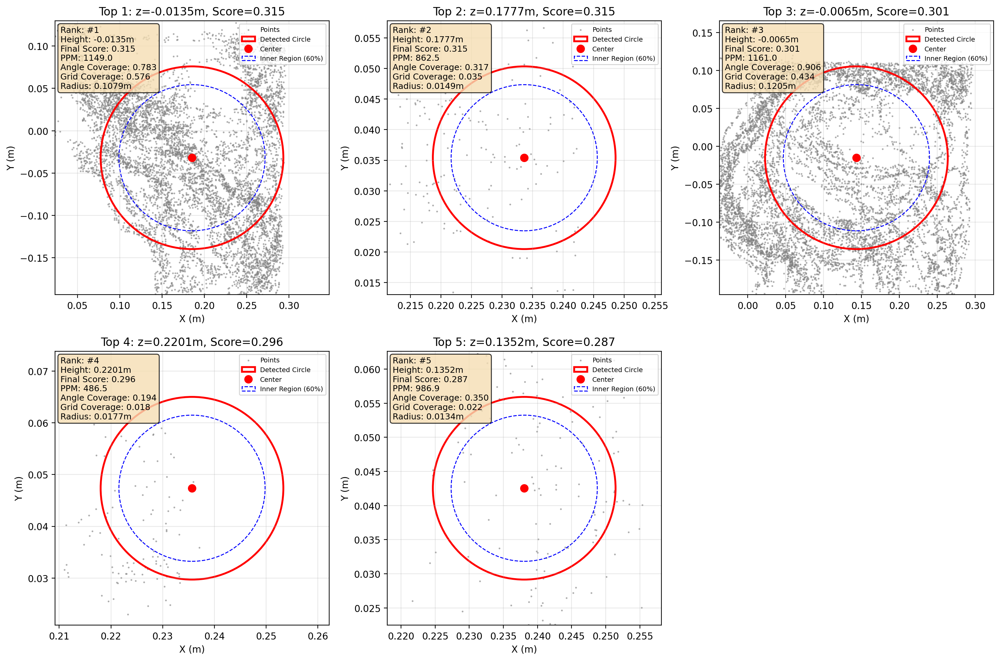


=== 상위 5개 원 통계 ===
Rank   Height(m)    Final Score  PPM        Angle Cov    Grid Cov     Radius(m)   
------------------------------------------------------------------------------------------
1      -0.0135      0.315        1149.0     0.783        0.576        0.1079      
2      0.1777       0.315        862.5      0.317        0.035        0.0149      
3      -0.0065      0.301        1161.0     0.906        0.434        0.1205      
4      0.2201       0.296        486.5      0.194        0.018        0.0177      
5      0.1352       0.287        986.9      0.350        0.022        0.0134      


In [87]:
visualize_top_circles(circle_data, sorted_points, sorted_heights, top_n=5, THICKNESS=THICKNESS)

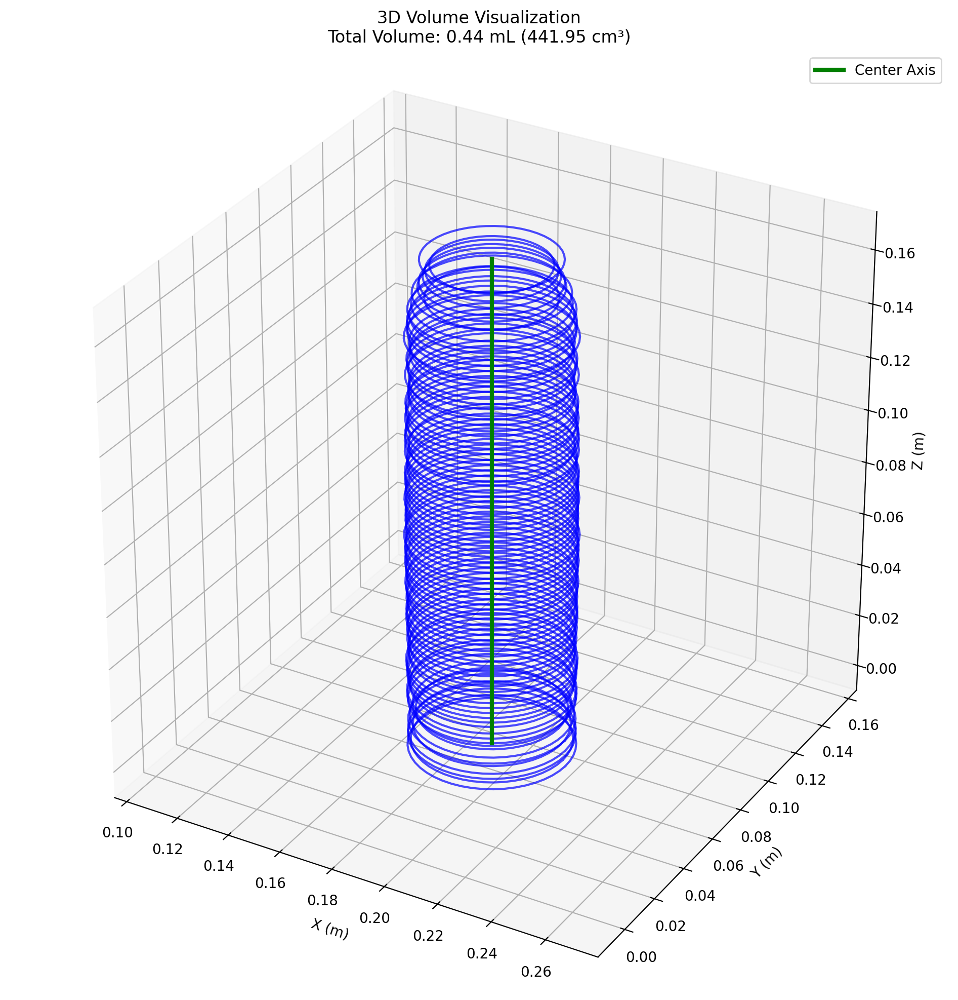

In [78]:
visualize_volume_3d(volume_data, center_axis)

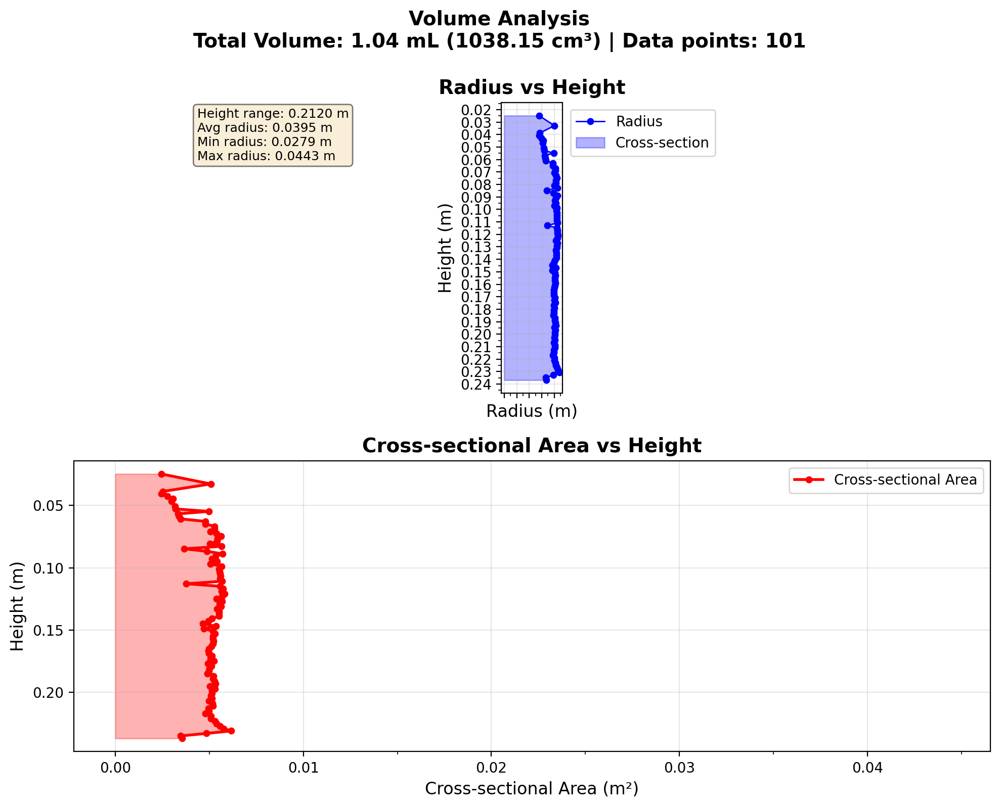

In [70]:
visualize_radius_vs_height(volume_data)

In [72]:
# 예시 2: 2D + 3D 시각화 (전체 포인트클라우드와 함께)
# 부피 측정 로직에서 사용하는 예시

# 1. 단면 추출
z = 0.0238
slice_points = get_slice(points, z)  # 3D 포인트 (M, 3)
slice_2d = slice_points[:, :2]  # 2D로 변환 (M, 2)

# 2. 원 검출
radius = detect_circle_at_axis(
    slice_2d, 
    center_axis, 
    max_radius=max_radius_limit
)

# 3. 시각화 (2D + 3D)
if radius is not None:
    visualize_circle_at_axis(
        slice_2d,                    # 2D 단면 포인트 (필수)
        center_axis,                # 중심축 좌표 (필수)
        radius,                     # 검출된 반지름 (필수)
        threshold=0.0025,          # 인라이너 임계값 (선택, 기본값 0.0025)
        z=z,                        # 단면의 z 좌표 (3D 시각화용, 필수)
        points_3d=points,           # 전체 포인트클라우드 (3D 시각화용, 필수)
        z_thickness=0.0003,         # 단면 두께 (선택, 기본값 0.0003)
        title=f'Circle at z={z:.4f}m'  # 그래프 제목 (선택)
    )